# DCGAN Assignment-3

## Importing necessary libraries

In [1]:
%matplotlib inline

In [ ]:
from __future__ import print_function
import argparse, os, random
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision 
from torchvision import datasets, transforms
import torch.utils as utils

import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

## Setting manual seed for reproducibility

In [3]:
manual_seed = 421
print("Random Seed : ", manual_seed)
random.seed(manual_seed)
torch.manual_seed(manual_seed)
np.random.seed(manual_seed)

Random Seed :  421


## Setting parameters and hyperparameters

In [18]:
batch_size = 16
image_size = 64
no_channels = 3
size_z = 100
no_gen_features = 64
no_disc_features = 64
num_epochs = 250
lr = 2e-3
beta1 = 0.9
beta2 = 0.999
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print("Device :",device)

Device : cuda


## Dataset processing

In [19]:
'''import shutil
import os
source = "Fruit-Images-Dataset/Training"
destination = "fruit_data"  
# code to move the files from sub-folder to main folder.
for folder in os.listdir(source):
	new_source = os.path.join(source, folder)
	for file in os.listdir(new_source):
		file_name = os.path.join(new_source, file)
		shutil.move(file_name, os.path.join(destination, file))
	print(new_source,"Completed")
print("Files Moved")'''

'import shutil\nimport os\nsource = "Fruit-Images-Dataset/Training"\ndestination = "fruit_data"  \n# code to move the files from sub-folder to main folder.\nfor folder in os.listdir(source):\n\tnew_source = os.path.join(source, folder)\n\tfor file in os.listdir(new_source):\n\t\tfile_name = os.path.join(new_source, file)\n\t\tshutil.move(file_name, os.path.join(destination, file))\n\tprint(new_source,"Completed")\nprint("Files Moved")'

## Data Loading

In [20]:
data_transforms = torchvision.transforms.Compose([
    transforms.Resize(image_size),
    transforms.ToTensor(),
    transforms.Normalize((0.5,0.5,0.5),(0.5,0.5,0.5)),
])
dataset = datasets.ImageFolder(root = 'fruit/',transform = data_transforms)
#dataset = datasets.CIFAR10(root='dataset/',train=True, transform=data_transforms,download=True)
dataloader = utils.data.DataLoader(dataset, batch_size=batch_size,shuffle=True,num_workers = 2)

## Dataset sample visualization

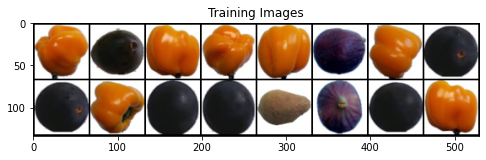

In [21]:
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.title("Training Images")
sample_grid = torchvision.utils.make_grid(real_batch[0][:64],nrow=8,normalize=True)
plt.imshow(np.transpose(sample_grid,(1,2,0)))

## Generator , Discriminator and Weights initilization

In [1]:
def initilize_weights(model):
    for m in model.modules():
        if isinstance(m,(nn.Conv2d, nn.ConvTranspose2d, nn.BatchNorm2d)):
            nn.init.normal_(m.weight.data, 0.0, 0.02)

In [23]:
class Generator(nn.Module):
    def __init__(self,no_channels, no_gen_features):
        super(Generator,self).__init__()
        #self.no_gen_features = no_gen_features
        self.gen = nn.Sequential(
            nn.ConvTranspose2d(size_z, no_gen_features*8, 4, 1, 0, bias =False),
            nn.BatchNorm2d(no_gen_features*8),
            nn.ReLU(),
            
            nn.ConvTranspose2d(no_gen_features*8, no_gen_features*4, 4, 2, 1, bias =False),
            nn.BatchNorm2d(no_gen_features*4),
            nn.ReLU(),
            
            nn.ConvTranspose2d(no_gen_features*4, no_gen_features*2, 4, 2, 1, bias =False),
            nn.BatchNorm2d(no_gen_features*2),
            nn.ReLU(),
            
            nn.ConvTranspose2d(no_gen_features*2, no_gen_features, 4, 2, 1, bias =False),
            nn.BatchNorm2d(no_gen_features),
            nn.ReLU(),
            
            nn.ConvTranspose2d(no_gen_features, no_channels, 4, 2, 1, bias =False),
            nn.Tanh()
        )
        
    def forward(self,x):
        return self.gen(x)

In [24]:
class Discriminator(nn.Module):
    def __init__(self,no_channels, no_disc_features):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            nn.Conv2d(no_channels, no_disc_features, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2),
            
            nn.Conv2d(no_disc_features, no_disc_features*2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(no_disc_features*2),
            nn.LeakyReLU(0.2),
            
            nn.Conv2d(no_disc_features*2, no_disc_features*4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(no_disc_features*4),
            nn.LeakyReLU(0.2),
            
            nn.Conv2d(no_disc_features*4, no_disc_features*8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(no_disc_features*8),
            nn.LeakyReLU(0.2),
            
            nn.Conv2d(no_disc_features*8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
            
        )
        
    def forward(self,x):
        return self.disc(x)

## Creating Generator and Discriminator instances and initilizing weigths

In [25]:
netG = Generator(no_channels, no_gen_features).to(device)
netD = Discriminator(no_channels, no_disc_features).to(device)
initilize_weights(netG)
initilize_weights(netD)

## Loss function and Optimizer

In [26]:
criterion = nn.BCELoss()
fixed_noise = torch.randn(batc,size_z,1,1).to(device)
optG = optim.Adam(netG.parameters(),lr=lr,betas=(beta1,beta2))
optD = optim.Adam(netD.parameters(),lr=lr,betas=(beta1,beta2))

## Generator fake image plotting

In [27]:
def show_image_grid(img):
    plt.imshow(img.permute(1, 2, 0))
    plt.axis('off')
    plt.show()

## Training Loop

Epoch : [1/250], Batch : [50/108], Loss_D : 0.113, Loss_G : 3.957, D(x) : 0.935, D(G(z)) : 0.042/0.029
Epoch : [1/250], Batch : [100/108], Loss_D : 0.055, Loss_G : 4.024, D(x) : 0.994, D(G(z)) : 0.047/0.031
Epoch : [2/250], Batch : [50/108], Loss_D : 0.527, Loss_G : 4.740, D(x) : 0.994, D(G(z)) : 0.350/0.021
Epoch : [2/250], Batch : [100/108], Loss_D : 0.042, Loss_G : 5.055, D(x) : 0.977, D(G(z)) : 0.018/0.010
Epoch : [3/250], Batch : [50/108], Loss_D : 0.010, Loss_G : 7.682, D(x) : 0.995, D(G(z)) : 0.005/0.001
Epoch : [3/250], Batch : [100/108], Loss_D : 0.185, Loss_G : 4.210, D(x) : 0.956, D(G(z)) : 0.123/0.036
Epoch : [4/250], Batch : [50/108], Loss_D : 0.007, Loss_G : 11.955, D(x) : 0.993, D(G(z)) : 0.000/0.000
Epoch : [4/250], Batch : [100/108], Loss_D : 0.001, Loss_G : 12.063, D(x) : 0.999, D(G(z)) : 0.000/0.000
Epoch : [5/250], Batch : [50/108], Loss_D : 0.001, Loss_G : 12.022, D(x) : 0.999, D(G(z)) : 0.000/0.000
Epoch : [5/250], Batch : [100/108], Loss_D : 0.001, Loss_G : 13.05

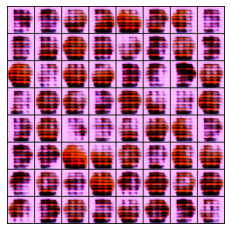

Epoch : [11/250], Batch : [50/108], Loss_D : 0.011, Loss_G : 7.015, D(x) : 0.992, D(G(z)) : 0.002/0.001
Epoch : [11/250], Batch : [100/108], Loss_D : 0.029, Loss_G : 6.129, D(x) : 0.999, D(G(z)) : 0.027/0.004
Epoch : [12/250], Batch : [50/108], Loss_D : 0.929, Loss_G : 5.678, D(x) : 0.491, D(G(z)) : 0.000/0.010
Epoch : [12/250], Batch : [100/108], Loss_D : 0.610, Loss_G : 4.074, D(x) : 1.000, D(G(z)) : 0.254/0.117
Epoch : [13/250], Batch : [50/108], Loss_D : 0.043, Loss_G : 6.650, D(x) : 0.982, D(G(z)) : 0.023/0.010
Epoch : [13/250], Batch : [100/108], Loss_D : 0.112, Loss_G : 4.337, D(x) : 0.985, D(G(z)) : 0.085/0.032
Epoch : [14/250], Batch : [50/108], Loss_D : 0.136, Loss_G : 5.966, D(x) : 0.885, D(G(z)) : 0.010/0.013
Epoch : [14/250], Batch : [100/108], Loss_D : 0.088, Loss_G : 6.185, D(x) : 0.926, D(G(z)) : 0.008/0.005
Epoch : [15/250], Batch : [50/108], Loss_D : 0.207, Loss_G : 6.038, D(x) : 0.891, D(G(z)) : 0.011/0.006
Epoch : [15/250], Batch : [100/108], Loss_D : 0.092, Loss_G 

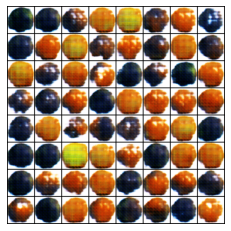

Epoch : [21/250], Batch : [50/108], Loss_D : 0.227, Loss_G : 3.762, D(x) : 0.994, D(G(z)) : 0.156/0.075
Epoch : [21/250], Batch : [100/108], Loss_D : 0.408, Loss_G : 3.826, D(x) : 0.960, D(G(z)) : 0.186/0.111
Epoch : [22/250], Batch : [50/108], Loss_D : 0.155, Loss_G : 3.440, D(x) : 0.983, D(G(z)) : 0.116/0.069
Epoch : [22/250], Batch : [100/108], Loss_D : 0.119, Loss_G : 4.592, D(x) : 0.996, D(G(z)) : 0.089/0.042
Epoch : [23/250], Batch : [50/108], Loss_D : 0.559, Loss_G : 6.213, D(x) : 0.644, D(G(z)) : 0.016/0.006
Epoch : [23/250], Batch : [100/108], Loss_D : 0.179, Loss_G : 3.672, D(x) : 0.999, D(G(z)) : 0.132/0.102
Epoch : [24/250], Batch : [50/108], Loss_D : 0.204, Loss_G : 2.898, D(x) : 0.900, D(G(z)) : 0.069/0.123
Epoch : [24/250], Batch : [100/108], Loss_D : 0.123, Loss_G : 5.992, D(x) : 0.935, D(G(z)) : 0.049/0.009
Epoch : [25/250], Batch : [50/108], Loss_D : 0.138, Loss_G : 5.782, D(x) : 0.944, D(G(z)) : 0.054/0.020
Epoch : [25/250], Batch : [100/108], Loss_D : 0.035, Loss_G 

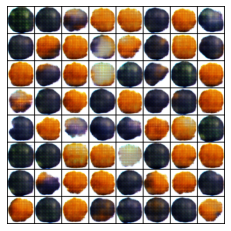

Epoch : [31/250], Batch : [50/108], Loss_D : 0.485, Loss_G : 1.928, D(x) : 0.878, D(G(z)) : 0.209/0.261
Epoch : [31/250], Batch : [100/108], Loss_D : 0.400, Loss_G : 3.356, D(x) : 0.833, D(G(z)) : 0.148/0.067
Epoch : [32/250], Batch : [50/108], Loss_D : 0.235, Loss_G : 5.667, D(x) : 0.840, D(G(z)) : 0.022/0.013
Epoch : [32/250], Batch : [100/108], Loss_D : 0.166, Loss_G : 5.410, D(x) : 0.875, D(G(z)) : 0.007/0.022
Epoch : [33/250], Batch : [50/108], Loss_D : 0.079, Loss_G : 7.344, D(x) : 0.937, D(G(z)) : 0.010/0.001
Epoch : [33/250], Batch : [100/108], Loss_D : 0.134, Loss_G : 4.734, D(x) : 0.957, D(G(z)) : 0.059/0.023
Epoch : [34/250], Batch : [50/108], Loss_D : 0.572, Loss_G : 4.991, D(x) : 0.994, D(G(z)) : 0.300/0.033
Epoch : [34/250], Batch : [100/108], Loss_D : 0.303, Loss_G : 2.048, D(x) : 0.997, D(G(z)) : 0.194/0.255
Epoch : [35/250], Batch : [50/108], Loss_D : 0.176, Loss_G : 6.603, D(x) : 0.873, D(G(z)) : 0.007/0.003
Epoch : [35/250], Batch : [100/108], Loss_D : 0.204, Loss_G 

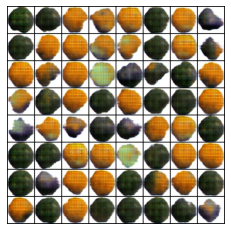

Epoch : [41/250], Batch : [50/108], Loss_D : 0.154, Loss_G : 5.227, D(x) : 0.883, D(G(z)) : 0.023/0.022
Epoch : [41/250], Batch : [100/108], Loss_D : 0.193, Loss_G : 5.358, D(x) : 0.906, D(G(z)) : 0.071/0.018
Epoch : [42/250], Batch : [50/108], Loss_D : 0.208, Loss_G : 5.467, D(x) : 0.998, D(G(z)) : 0.085/0.060
Epoch : [42/250], Batch : [100/108], Loss_D : 0.405, Loss_G : 3.635, D(x) : 0.914, D(G(z)) : 0.235/0.045
Epoch : [43/250], Batch : [50/108], Loss_D : 0.162, Loss_G : 3.151, D(x) : 0.985, D(G(z)) : 0.122/0.115
Epoch : [43/250], Batch : [100/108], Loss_D : 0.702, Loss_G : 2.572, D(x) : 0.543, D(G(z)) : 0.028/0.264
Epoch : [44/250], Batch : [50/108], Loss_D : 0.071, Loss_G : 6.873, D(x) : 0.947, D(G(z)) : 0.012/0.008
Epoch : [44/250], Batch : [100/108], Loss_D : 0.737, Loss_G : 6.951, D(x) : 0.578, D(G(z)) : 0.003/0.002
Epoch : [45/250], Batch : [50/108], Loss_D : 1.879, Loss_G : 2.481, D(x) : 0.304, D(G(z)) : 0.112/0.195
Epoch : [45/250], Batch : [100/108], Loss_D : 0.051, Loss_G 

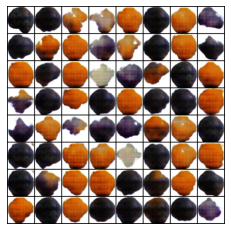

Epoch : [51/250], Batch : [50/108], Loss_D : 0.036, Loss_G : 4.688, D(x) : 0.989, D(G(z)) : 0.023/0.018
Epoch : [51/250], Batch : [100/108], Loss_D : 0.449, Loss_G : 2.991, D(x) : 0.999, D(G(z)) : 0.277/0.106
Epoch : [52/250], Batch : [50/108], Loss_D : 0.738, Loss_G : 5.296, D(x) : 0.661, D(G(z)) : 0.151/0.029
Epoch : [52/250], Batch : [100/108], Loss_D : 0.031, Loss_G : 6.388, D(x) : 0.975, D(G(z)) : 0.005/0.003
Epoch : [53/250], Batch : [50/108], Loss_D : 0.252, Loss_G : 5.057, D(x) : 0.846, D(G(z)) : 0.070/0.022
Epoch : [53/250], Batch : [100/108], Loss_D : 0.153, Loss_G : 5.491, D(x) : 0.993, D(G(z)) : 0.128/0.008
Epoch : [54/250], Batch : [50/108], Loss_D : 0.516, Loss_G : 5.626, D(x) : 0.820, D(G(z)) : 0.012/0.006
Epoch : [54/250], Batch : [100/108], Loss_D : 0.802, Loss_G : 2.437, D(x) : 0.903, D(G(z)) : 0.343/0.138
Epoch : [55/250], Batch : [50/108], Loss_D : 0.424, Loss_G : 7.141, D(x) : 0.731, D(G(z)) : 0.006/0.003
Epoch : [55/250], Batch : [100/108], Loss_D : 0.243, Loss_G 

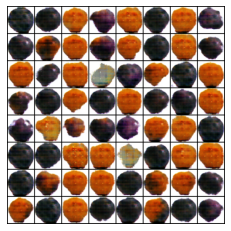

Epoch : [61/250], Batch : [50/108], Loss_D : 0.258, Loss_G : 3.260, D(x) : 0.960, D(G(z)) : 0.178/0.095
Epoch : [61/250], Batch : [100/108], Loss_D : 0.031, Loss_G : 6.874, D(x) : 0.976, D(G(z)) : 0.006/0.004
Epoch : [62/250], Batch : [50/108], Loss_D : 0.047, Loss_G : 6.957, D(x) : 0.978, D(G(z)) : 0.023/0.002
Epoch : [62/250], Batch : [100/108], Loss_D : 0.477, Loss_G : 6.756, D(x) : 0.796, D(G(z)) : 0.020/0.007
Epoch : [63/250], Batch : [50/108], Loss_D : 0.135, Loss_G : 4.249, D(x) : 0.963, D(G(z)) : 0.080/0.041
Epoch : [63/250], Batch : [100/108], Loss_D : 0.250, Loss_G : 3.663, D(x) : 0.933, D(G(z)) : 0.122/0.076
Epoch : [64/250], Batch : [50/108], Loss_D : 0.934, Loss_G : 4.929, D(x) : 0.989, D(G(z)) : 0.461/0.019
Epoch : [64/250], Batch : [100/108], Loss_D : 0.067, Loss_G : 4.588, D(x) : 0.949, D(G(z)) : 0.006/0.013
Epoch : [65/250], Batch : [50/108], Loss_D : 0.280, Loss_G : 4.263, D(x) : 0.914, D(G(z)) : 0.139/0.031
Epoch : [65/250], Batch : [100/108], Loss_D : 0.389, Loss_G 

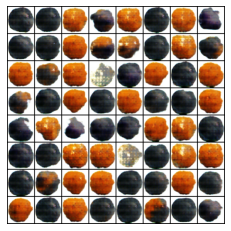

Epoch : [71/250], Batch : [50/108], Loss_D : 0.436, Loss_G : 2.930, D(x) : 0.911, D(G(z)) : 0.254/0.075
Epoch : [71/250], Batch : [100/108], Loss_D : 0.268, Loss_G : 4.282, D(x) : 0.863, D(G(z)) : 0.091/0.041
Epoch : [72/250], Batch : [50/108], Loss_D : 1.015, Loss_G : 3.932, D(x) : 0.725, D(G(z)) : 0.359/0.070
Epoch : [72/250], Batch : [100/108], Loss_D : 0.507, Loss_G : 3.802, D(x) : 0.693, D(G(z)) : 0.066/0.051
Epoch : [73/250], Batch : [50/108], Loss_D : 0.044, Loss_G : 8.797, D(x) : 0.960, D(G(z)) : 0.001/0.000
Epoch : [73/250], Batch : [100/108], Loss_D : 0.200, Loss_G : 4.198, D(x) : 0.974, D(G(z)) : 0.128/0.029
Epoch : [74/250], Batch : [50/108], Loss_D : 0.259, Loss_G : 4.157, D(x) : 0.978, D(G(z)) : 0.164/0.061
Epoch : [74/250], Batch : [100/108], Loss_D : 0.230, Loss_G : 4.740, D(x) : 0.928, D(G(z)) : 0.117/0.032
Epoch : [75/250], Batch : [50/108], Loss_D : 0.084, Loss_G : 6.707, D(x) : 0.930, D(G(z)) : 0.009/0.006
Epoch : [75/250], Batch : [100/108], Loss_D : 0.245, Loss_G 

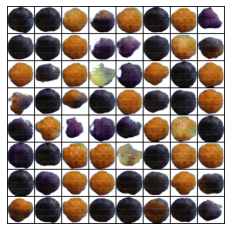

Epoch : [81/250], Batch : [50/108], Loss_D : 0.209, Loss_G : 4.406, D(x) : 0.979, D(G(z)) : 0.139/0.079
Epoch : [81/250], Batch : [100/108], Loss_D : 0.322, Loss_G : 3.268, D(x) : 0.997, D(G(z)) : 0.223/0.081
Epoch : [82/250], Batch : [50/108], Loss_D : 0.100, Loss_G : 6.703, D(x) : 0.999, D(G(z)) : 0.073/0.014
Epoch : [82/250], Batch : [100/108], Loss_D : 0.416, Loss_G : 4.790, D(x) : 0.756, D(G(z)) : 0.046/0.039
Epoch : [83/250], Batch : [50/108], Loss_D : 0.122, Loss_G : 5.019, D(x) : 0.963, D(G(z)) : 0.073/0.028
Epoch : [83/250], Batch : [100/108], Loss_D : 0.067, Loss_G : 5.668, D(x) : 0.991, D(G(z)) : 0.049/0.016
Epoch : [84/250], Batch : [50/108], Loss_D : 0.207, Loss_G : 3.277, D(x) : 0.967, D(G(z)) : 0.084/0.112
Epoch : [84/250], Batch : [100/108], Loss_D : 0.256, Loss_G : 4.551, D(x) : 0.944, D(G(z)) : 0.101/0.056
Epoch : [85/250], Batch : [50/108], Loss_D : 1.048, Loss_G : 4.965, D(x) : 0.529, D(G(z)) : 0.020/0.027
Epoch : [85/250], Batch : [100/108], Loss_D : 1.141, Loss_G 

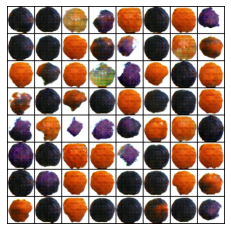

Epoch : [91/250], Batch : [50/108], Loss_D : 0.207, Loss_G : 5.311, D(x) : 0.984, D(G(z)) : 0.129/0.019
Epoch : [91/250], Batch : [100/108], Loss_D : 0.111, Loss_G : 4.970, D(x) : 0.986, D(G(z)) : 0.081/0.061
Epoch : [92/250], Batch : [50/108], Loss_D : 0.009, Loss_G : 6.756, D(x) : 0.999, D(G(z)) : 0.008/0.004
Epoch : [92/250], Batch : [100/108], Loss_D : 0.151, Loss_G : 4.134, D(x) : 0.891, D(G(z)) : 0.032/0.024
Epoch : [93/250], Batch : [50/108], Loss_D : 0.558, Loss_G : 2.939, D(x) : 0.727, D(G(z)) : 0.053/0.111
Epoch : [93/250], Batch : [100/108], Loss_D : 0.237, Loss_G : 9.662, D(x) : 0.847, D(G(z)) : 0.001/0.001
Epoch : [94/250], Batch : [50/108], Loss_D : 0.167, Loss_G : 9.434, D(x) : 0.876, D(G(z)) : 0.000/0.001
Epoch : [94/250], Batch : [100/108], Loss_D : 0.096, Loss_G : 6.822, D(x) : 0.993, D(G(z)) : 0.076/0.018
Epoch : [95/250], Batch : [50/108], Loss_D : 0.040, Loss_G : 8.764, D(x) : 0.963, D(G(z)) : 0.001/0.001
Epoch : [95/250], Batch : [100/108], Loss_D : 0.301, Loss_G 

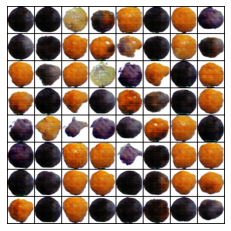

Epoch : [101/250], Batch : [50/108], Loss_D : 0.906, Loss_G : 4.541, D(x) : 0.922, D(G(z)) : 0.411/0.033
Epoch : [101/250], Batch : [100/108], Loss_D : 0.831, Loss_G : 1.991, D(x) : 0.554, D(G(z)) : 0.032/0.300
Epoch : [102/250], Batch : [50/108], Loss_D : 0.116, Loss_G : 6.751, D(x) : 0.905, D(G(z)) : 0.006/0.004
Epoch : [102/250], Batch : [100/108], Loss_D : 0.031, Loss_G : 6.667, D(x) : 0.981, D(G(z)) : 0.011/0.009
Epoch : [103/250], Batch : [50/108], Loss_D : 0.167, Loss_G : 3.800, D(x) : 0.978, D(G(z)) : 0.117/0.065
Epoch : [103/250], Batch : [100/108], Loss_D : 0.936, Loss_G : 6.712, D(x) : 0.510, D(G(z)) : 0.001/0.005
Epoch : [104/250], Batch : [50/108], Loss_D : 0.477, Loss_G : 8.185, D(x) : 0.722, D(G(z)) : 0.001/0.002
Epoch : [104/250], Batch : [100/108], Loss_D : 2.200, Loss_G : 2.508, D(x) : 0.992, D(G(z)) : 0.807/0.183
Epoch : [105/250], Batch : [50/108], Loss_D : 0.037, Loss_G : 9.964, D(x) : 0.965, D(G(z)) : 0.000/0.000
Epoch : [105/250], Batch : [100/108], Loss_D : 0.01

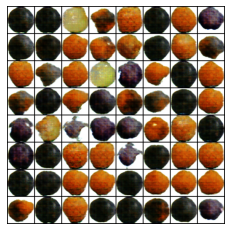

Epoch : [111/250], Batch : [50/108], Loss_D : 0.031, Loss_G : 9.078, D(x) : 0.971, D(G(z)) : 0.002/0.001
Epoch : [111/250], Batch : [100/108], Loss_D : 0.393, Loss_G : 4.661, D(x) : 0.987, D(G(z)) : 0.256/0.027
Epoch : [112/250], Batch : [50/108], Loss_D : 0.060, Loss_G : 6.365, D(x) : 0.977, D(G(z)) : 0.034/0.005
Epoch : [112/250], Batch : [100/108], Loss_D : 0.142, Loss_G : 5.216, D(x) : 0.960, D(G(z)) : 0.079/0.025
Epoch : [113/250], Batch : [50/108], Loss_D : 0.334, Loss_G : 3.913, D(x) : 0.976, D(G(z)) : 0.184/0.065
Epoch : [113/250], Batch : [100/108], Loss_D : 0.272, Loss_G : 2.397, D(x) : 0.997, D(G(z)) : 0.207/0.165
Epoch : [114/250], Batch : [50/108], Loss_D : 0.047, Loss_G : 5.662, D(x) : 0.983, D(G(z)) : 0.028/0.014
Epoch : [114/250], Batch : [100/108], Loss_D : 0.106, Loss_G : 5.503, D(x) : 0.980, D(G(z)) : 0.072/0.037
Epoch : [115/250], Batch : [50/108], Loss_D : 0.064, Loss_G : 3.911, D(x) : 0.994, D(G(z)) : 0.054/0.074
Epoch : [115/250], Batch : [100/108], Loss_D : 0.60

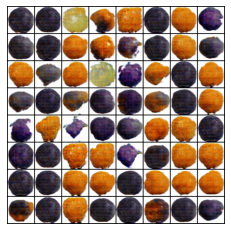

Epoch : [121/250], Batch : [50/108], Loss_D : 0.169, Loss_G : 4.624, D(x) : 0.995, D(G(z)) : 0.117/0.066
Epoch : [121/250], Batch : [100/108], Loss_D : 0.212, Loss_G : 5.678, D(x) : 0.902, D(G(z)) : 0.067/0.037
Epoch : [122/250], Batch : [50/108], Loss_D : 0.501, Loss_G : 4.269, D(x) : 0.957, D(G(z)) : 0.269/0.055
Epoch : [122/250], Batch : [100/108], Loss_D : 0.275, Loss_G : 8.403, D(x) : 0.818, D(G(z)) : 0.005/0.002
Epoch : [123/250], Batch : [50/108], Loss_D : 0.083, Loss_G : 7.496, D(x) : 0.930, D(G(z)) : 0.008/0.002
Epoch : [123/250], Batch : [100/108], Loss_D : 0.078, Loss_G : 4.992, D(x) : 0.999, D(G(z)) : 0.068/0.027
Epoch : [124/250], Batch : [50/108], Loss_D : 0.010, Loss_G : 7.180, D(x) : 0.996, D(G(z)) : 0.007/0.005
Epoch : [124/250], Batch : [100/108], Loss_D : 0.320, Loss_G : 9.196, D(x) : 0.821, D(G(z)) : 0.027/0.025
Epoch : [125/250], Batch : [50/108], Loss_D : 0.470, Loss_G : 4.905, D(x) : 0.713, D(G(z)) : 0.031/0.062
Epoch : [125/250], Batch : [100/108], Loss_D : 0.20

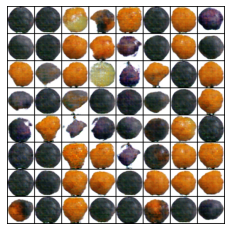

Epoch : [131/250], Batch : [50/108], Loss_D : 0.153, Loss_G : 6.946, D(x) : 0.890, D(G(z)) : 0.025/0.012
Epoch : [131/250], Batch : [100/108], Loss_D : 0.058, Loss_G : 5.145, D(x) : 0.985, D(G(z)) : 0.036/0.040
Epoch : [132/250], Batch : [50/108], Loss_D : 0.119, Loss_G : 4.678, D(x) : 0.948, D(G(z)) : 0.059/0.057
Epoch : [132/250], Batch : [100/108], Loss_D : 0.112, Loss_G : 5.374, D(x) : 0.965, D(G(z)) : 0.060/0.025
Epoch : [133/250], Batch : [50/108], Loss_D : 0.014, Loss_G : 6.116, D(x) : 0.997, D(G(z)) : 0.011/0.006
Epoch : [133/250], Batch : [100/108], Loss_D : 0.037, Loss_G : 7.967, D(x) : 0.999, D(G(z)) : 0.031/0.015
Epoch : [134/250], Batch : [50/108], Loss_D : 0.068, Loss_G : 3.440, D(x) : 0.988, D(G(z)) : 0.051/0.059
Epoch : [134/250], Batch : [100/108], Loss_D : 0.234, Loss_G : 3.256, D(x) : 0.991, D(G(z)) : 0.171/0.151
Epoch : [135/250], Batch : [50/108], Loss_D : 0.351, Loss_G : 4.524, D(x) : 0.994, D(G(z)) : 0.186/0.084
Epoch : [135/250], Batch : [100/108], Loss_D : 0.03

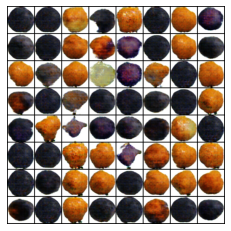

Epoch : [141/250], Batch : [50/108], Loss_D : 0.187, Loss_G : 5.164, D(x) : 1.000, D(G(z)) : 0.147/0.022
Epoch : [141/250], Batch : [100/108], Loss_D : 0.399, Loss_G : 8.337, D(x) : 0.724, D(G(z)) : 0.000/0.001
Epoch : [142/250], Batch : [50/108], Loss_D : 0.105, Loss_G : 6.155, D(x) : 0.915, D(G(z)) : 0.005/0.015
Epoch : [142/250], Batch : [100/108], Loss_D : 0.020, Loss_G : 6.727, D(x) : 0.993, D(G(z)) : 0.012/0.010
Epoch : [143/250], Batch : [50/108], Loss_D : 0.007, Loss_G : 7.332, D(x) : 0.996, D(G(z)) : 0.004/0.002
Epoch : [143/250], Batch : [100/108], Loss_D : 0.071, Loss_G : 6.755, D(x) : 0.976, D(G(z)) : 0.036/0.017
Epoch : [144/250], Batch : [50/108], Loss_D : 0.057, Loss_G : 5.371, D(x) : 0.999, D(G(z)) : 0.051/0.022
Epoch : [144/250], Batch : [100/108], Loss_D : 0.040, Loss_G : 6.510, D(x) : 0.970, D(G(z)) : 0.009/0.008
Epoch : [145/250], Batch : [50/108], Loss_D : 0.031, Loss_G : 8.306, D(x) : 0.976, D(G(z)) : 0.005/0.005
Epoch : [145/250], Batch : [100/108], Loss_D : 0.55

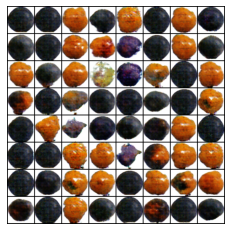

Epoch : [151/250], Batch : [50/108], Loss_D : 0.284, Loss_G : 4.349, D(x) : 0.910, D(G(z)) : 0.119/0.161
Epoch : [151/250], Batch : [100/108], Loss_D : 0.096, Loss_G : 4.744, D(x) : 0.967, D(G(z)) : 0.056/0.037
Epoch : [152/250], Batch : [50/108], Loss_D : 0.068, Loss_G : 5.663, D(x) : 0.967, D(G(z)) : 0.031/0.017
Epoch : [152/250], Batch : [100/108], Loss_D : 0.053, Loss_G : 5.918, D(x) : 0.980, D(G(z)) : 0.030/0.016
Epoch : [153/250], Batch : [50/108], Loss_D : 0.025, Loss_G : 6.047, D(x) : 0.986, D(G(z)) : 0.011/0.019
Epoch : [153/250], Batch : [100/108], Loss_D : 0.058, Loss_G : 5.569, D(x) : 0.996, D(G(z)) : 0.048/0.010
Epoch : [154/250], Batch : [50/108], Loss_D : 0.038, Loss_G : 6.594, D(x) : 1.000, D(G(z)) : 0.030/0.023
Epoch : [154/250], Batch : [100/108], Loss_D : 0.016, Loss_G : 5.648, D(x) : 0.999, D(G(z)) : 0.015/0.010
Epoch : [155/250], Batch : [50/108], Loss_D : 0.143, Loss_G : 8.414, D(x) : 0.888, D(G(z)) : 0.003/0.004
Epoch : [155/250], Batch : [100/108], Loss_D : 0.01

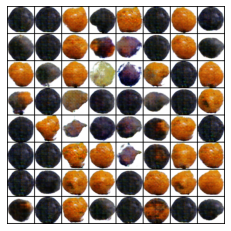

Epoch : [161/250], Batch : [50/108], Loss_D : 0.418, Loss_G : 6.964, D(x) : 0.764, D(G(z)) : 0.006/0.003
Epoch : [161/250], Batch : [100/108], Loss_D : 0.681, Loss_G : 5.281, D(x) : 0.769, D(G(z)) : 0.071/0.073
Epoch : [162/250], Batch : [50/108], Loss_D : 0.171, Loss_G : 3.971, D(x) : 0.971, D(G(z)) : 0.115/0.046
Epoch : [162/250], Batch : [100/108], Loss_D : 0.010, Loss_G : 5.933, D(x) : 0.999, D(G(z)) : 0.009/0.016
Epoch : [163/250], Batch : [50/108], Loss_D : 0.009, Loss_G : 6.415, D(x) : 0.996, D(G(z)) : 0.005/0.009
Epoch : [163/250], Batch : [100/108], Loss_D : 0.439, Loss_G : 3.799, D(x) : 1.000, D(G(z)) : 0.242/0.126
Epoch : [164/250], Batch : [50/108], Loss_D : 0.412, Loss_G : 8.660, D(x) : 0.752, D(G(z)) : 0.010/0.012
Epoch : [164/250], Batch : [100/108], Loss_D : 0.015, Loss_G : 6.919, D(x) : 1.000, D(G(z)) : 0.014/0.017
Epoch : [165/250], Batch : [50/108], Loss_D : 0.033, Loss_G : 8.242, D(x) : 0.970, D(G(z)) : 0.002/0.003
Epoch : [165/250], Batch : [100/108], Loss_D : 0.39

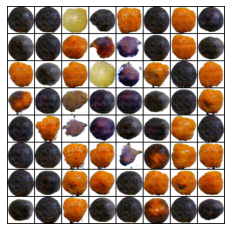

Epoch : [171/250], Batch : [50/108], Loss_D : 0.001, Loss_G : 9.858, D(x) : 0.999, D(G(z)) : 0.001/0.000
Epoch : [171/250], Batch : [100/108], Loss_D : 0.077, Loss_G : 13.874, D(x) : 0.929, D(G(z)) : 0.000/0.000
Epoch : [172/250], Batch : [50/108], Loss_D : 0.154, Loss_G : 10.407, D(x) : 0.868, D(G(z)) : 0.000/0.000
Epoch : [172/250], Batch : [100/108], Loss_D : 0.121, Loss_G : 6.935, D(x) : 0.899, D(G(z)) : 0.006/0.008
Epoch : [173/250], Batch : [50/108], Loss_D : 0.052, Loss_G : 8.311, D(x) : 0.953, D(G(z)) : 0.001/0.001
Epoch : [173/250], Batch : [100/108], Loss_D : 0.043, Loss_G : 6.416, D(x) : 0.975, D(G(z)) : 0.016/0.007
Epoch : [174/250], Batch : [50/108], Loss_D : 0.024, Loss_G : 7.247, D(x) : 1.000, D(G(z)) : 0.022/0.007
Epoch : [174/250], Batch : [100/108], Loss_D : 0.029, Loss_G : 8.852, D(x) : 0.979, D(G(z)) : 0.006/0.001
Epoch : [175/250], Batch : [50/108], Loss_D : 0.051, Loss_G : 6.927, D(x) : 0.965, D(G(z)) : 0.012/0.007
Epoch : [175/250], Batch : [100/108], Loss_D : 0.

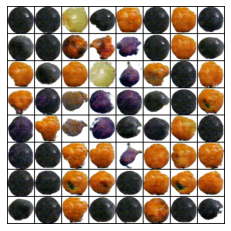

Epoch : [181/250], Batch : [50/108], Loss_D : 0.079, Loss_G : 10.892, D(x) : 0.930, D(G(z)) : 0.000/0.000
Epoch : [181/250], Batch : [100/108], Loss_D : 0.181, Loss_G : 4.166, D(x) : 0.999, D(G(z)) : 0.123/0.067
Epoch : [182/250], Batch : [50/108], Loss_D : 0.016, Loss_G : 7.560, D(x) : 1.000, D(G(z)) : 0.015/0.003
Epoch : [182/250], Batch : [100/108], Loss_D : 0.189, Loss_G : 5.668, D(x) : 0.948, D(G(z)) : 0.083/0.055
Epoch : [183/250], Batch : [50/108], Loss_D : 0.030, Loss_G : 5.830, D(x) : 0.987, D(G(z)) : 0.016/0.015
Epoch : [183/250], Batch : [100/108], Loss_D : 0.013, Loss_G : 8.555, D(x) : 0.999, D(G(z)) : 0.011/0.009
Epoch : [184/250], Batch : [50/108], Loss_D : 0.069, Loss_G : 6.440, D(x) : 0.998, D(G(z)) : 0.047/0.024
Epoch : [184/250], Batch : [100/108], Loss_D : 0.024, Loss_G : 6.167, D(x) : 0.999, D(G(z)) : 0.022/0.011
Epoch : [185/250], Batch : [50/108], Loss_D : 0.811, Loss_G : 4.502, D(x) : 0.999, D(G(z)) : 0.333/0.062
Epoch : [185/250], Batch : [100/108], Loss_D : 0.0

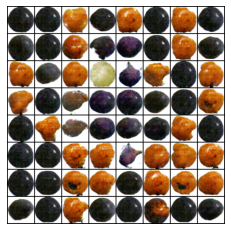

Epoch : [191/250], Batch : [50/108], Loss_D : 0.029, Loss_G : 10.399, D(x) : 0.991, D(G(z)) : 0.019/0.002
Epoch : [191/250], Batch : [100/108], Loss_D : 1.015, Loss_G : 4.229, D(x) : 0.961, D(G(z)) : 0.334/0.140
Epoch : [192/250], Batch : [50/108], Loss_D : 0.180, Loss_G : 4.787, D(x) : 1.000, D(G(z)) : 0.108/0.054
Epoch : [192/250], Batch : [100/108], Loss_D : 0.042, Loss_G : 6.009, D(x) : 0.977, D(G(z)) : 0.017/0.020
Epoch : [193/250], Batch : [50/108], Loss_D : 0.019, Loss_G : 5.723, D(x) : 0.999, D(G(z)) : 0.017/0.029
Epoch : [193/250], Batch : [100/108], Loss_D : 0.052, Loss_G : 5.888, D(x) : 0.999, D(G(z)) : 0.046/0.030
Epoch : [194/250], Batch : [50/108], Loss_D : 0.025, Loss_G : 6.436, D(x) : 0.999, D(G(z)) : 0.023/0.008
Epoch : [194/250], Batch : [100/108], Loss_D : 0.021, Loss_G : 7.769, D(x) : 1.000, D(G(z)) : 0.019/0.009
Epoch : [195/250], Batch : [50/108], Loss_D : 0.008, Loss_G : 7.828, D(x) : 0.998, D(G(z)) : 0.007/0.009
Epoch : [195/250], Batch : [100/108], Loss_D : 0.0

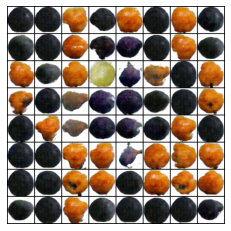

Epoch : [201/250], Batch : [50/108], Loss_D : 0.100, Loss_G : 5.216, D(x) : 1.000, D(G(z)) : 0.088/0.042
Epoch : [201/250], Batch : [100/108], Loss_D : 0.004, Loss_G : 8.223, D(x) : 0.999, D(G(z)) : 0.004/0.002
Epoch : [202/250], Batch : [50/108], Loss_D : 0.028, Loss_G : 6.335, D(x) : 0.990, D(G(z)) : 0.017/0.013
Epoch : [202/250], Batch : [100/108], Loss_D : 0.014, Loss_G : 7.951, D(x) : 0.992, D(G(z)) : 0.006/0.007
Epoch : [203/250], Batch : [50/108], Loss_D : 0.002, Loss_G : 11.690, D(x) : 0.998, D(G(z)) : 0.000/0.000
Epoch : [203/250], Batch : [100/108], Loss_D : 0.029, Loss_G : 6.598, D(x) : 0.974, D(G(z)) : 0.001/0.013
Epoch : [204/250], Batch : [50/108], Loss_D : 0.398, Loss_G : 5.711, D(x) : 0.880, D(G(z)) : 0.071/0.034
Epoch : [204/250], Batch : [100/108], Loss_D : 0.211, Loss_G : 5.361, D(x) : 0.985, D(G(z)) : 0.124/0.096
Epoch : [205/250], Batch : [50/108], Loss_D : 0.009, Loss_G : 9.712, D(x) : 0.994, D(G(z)) : 0.003/0.003
Epoch : [205/250], Batch : [100/108], Loss_D : 0.0

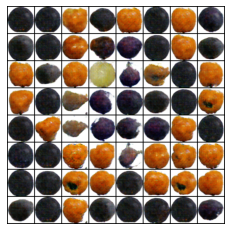

Epoch : [211/250], Batch : [50/108], Loss_D : 0.005, Loss_G : 8.208, D(x) : 0.999, D(G(z)) : 0.004/0.002
Epoch : [211/250], Batch : [100/108], Loss_D : 0.014, Loss_G : 10.974, D(x) : 0.987, D(G(z)) : 0.001/0.000
Epoch : [212/250], Batch : [50/108], Loss_D : 0.060, Loss_G : 5.248, D(x) : 0.999, D(G(z)) : 0.051/0.026
Epoch : [212/250], Batch : [100/108], Loss_D : 0.002, Loss_G : 9.360, D(x) : 1.000, D(G(z)) : 0.001/0.001
Epoch : [213/250], Batch : [50/108], Loss_D : 0.008, Loss_G : 8.512, D(x) : 0.994, D(G(z)) : 0.002/0.002
Epoch : [213/250], Batch : [100/108], Loss_D : 0.019, Loss_G : 6.784, D(x) : 0.999, D(G(z)) : 0.017/0.012
Epoch : [214/250], Batch : [50/108], Loss_D : 0.032, Loss_G : 6.624, D(x) : 0.979, D(G(z)) : 0.010/0.004
Epoch : [214/250], Batch : [100/108], Loss_D : 0.018, Loss_G : 6.943, D(x) : 0.999, D(G(z)) : 0.016/0.011
Epoch : [215/250], Batch : [50/108], Loss_D : 0.103, Loss_G : 11.032, D(x) : 0.913, D(G(z)) : 0.000/0.001
Epoch : [215/250], Batch : [100/108], Loss_D : 0.

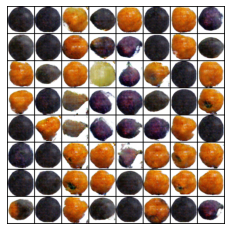

Epoch : [221/250], Batch : [50/108], Loss_D : 0.003, Loss_G : 10.397, D(x) : 0.998, D(G(z)) : 0.000/0.001
Epoch : [221/250], Batch : [100/108], Loss_D : 0.022, Loss_G : 7.748, D(x) : 0.985, D(G(z)) : 0.006/0.005
Epoch : [222/250], Batch : [50/108], Loss_D : 0.006, Loss_G : 10.249, D(x) : 0.994, D(G(z)) : 0.001/0.001
Epoch : [222/250], Batch : [100/108], Loss_D : 0.017, Loss_G : 7.198, D(x) : 0.999, D(G(z)) : 0.015/0.008
Epoch : [223/250], Batch : [50/108], Loss_D : 0.203, Loss_G : 12.041, D(x) : 0.847, D(G(z)) : 0.000/0.000
Epoch : [223/250], Batch : [100/108], Loss_D : 0.017, Loss_G : 10.132, D(x) : 0.985, D(G(z)) : 0.001/0.001
Epoch : [224/250], Batch : [50/108], Loss_D : 0.044, Loss_G : 6.857, D(x) : 1.000, D(G(z)) : 0.035/0.007
Epoch : [224/250], Batch : [100/108], Loss_D : 0.213, Loss_G : 4.805, D(x) : 0.978, D(G(z)) : 0.106/0.048
Epoch : [225/250], Batch : [50/108], Loss_D : 0.046, Loss_G : 6.694, D(x) : 1.000, D(G(z)) : 0.037/0.014
Epoch : [225/250], Batch : [100/108], Loss_D : 

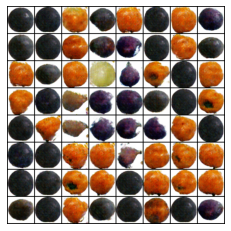

Epoch : [231/250], Batch : [50/108], Loss_D : 0.118, Loss_G : 9.695, D(x) : 0.929, D(G(z)) : 0.000/0.000
Epoch : [231/250], Batch : [100/108], Loss_D : 0.001, Loss_G : 9.976, D(x) : 1.000, D(G(z)) : 0.001/0.000
Epoch : [232/250], Batch : [50/108], Loss_D : 0.008, Loss_G : 7.615, D(x) : 1.000, D(G(z)) : 0.008/0.002
Epoch : [232/250], Batch : [100/108], Loss_D : 0.091, Loss_G : 5.122, D(x) : 0.992, D(G(z)) : 0.074/0.059
Epoch : [233/250], Batch : [50/108], Loss_D : 0.107, Loss_G : 5.415, D(x) : 0.998, D(G(z)) : 0.085/0.042
Epoch : [233/250], Batch : [100/108], Loss_D : 0.055, Loss_G : 7.703, D(x) : 0.999, D(G(z)) : 0.044/0.026
Epoch : [234/250], Batch : [50/108], Loss_D : 0.083, Loss_G : 5.270, D(x) : 1.000, D(G(z)) : 0.068/0.080
Epoch : [234/250], Batch : [100/108], Loss_D : 0.550, Loss_G : 6.109, D(x) : 0.771, D(G(z)) : 0.056/0.032
Epoch : [235/250], Batch : [50/108], Loss_D : 0.020, Loss_G : 7.859, D(x) : 1.000, D(G(z)) : 0.019/0.008
Epoch : [235/250], Batch : [100/108], Loss_D : 0.37

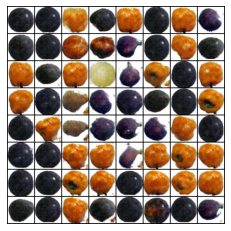

Epoch : [241/250], Batch : [50/108], Loss_D : 0.008, Loss_G : 8.895, D(x) : 0.995, D(G(z)) : 0.002/0.002
Epoch : [241/250], Batch : [100/108], Loss_D : 0.020, Loss_G : 15.253, D(x) : 0.980, D(G(z)) : 0.000/0.000
Epoch : [242/250], Batch : [50/108], Loss_D : 0.003, Loss_G : 9.822, D(x) : 0.997, D(G(z)) : 0.000/0.000
Epoch : [242/250], Batch : [100/108], Loss_D : 0.115, Loss_G : 8.365, D(x) : 0.920, D(G(z)) : 0.002/0.002
Epoch : [243/250], Batch : [50/108], Loss_D : 0.002, Loss_G : 7.980, D(x) : 1.000, D(G(z)) : 0.002/0.001
Epoch : [243/250], Batch : [100/108], Loss_D : 0.093, Loss_G : 4.255, D(x) : 0.998, D(G(z)) : 0.083/0.037
Epoch : [244/250], Batch : [50/108], Loss_D : 0.001, Loss_G : 8.199, D(x) : 1.000, D(G(z)) : 0.001/0.001
Epoch : [244/250], Batch : [100/108], Loss_D : 0.012, Loss_G : 7.691, D(x) : 1.000, D(G(z)) : 0.012/0.006
Epoch : [245/250], Batch : [50/108], Loss_D : 0.005, Loss_G : 8.752, D(x) : 1.000, D(G(z)) : 0.005/0.003
Epoch : [245/250], Batch : [100/108], Loss_D : 0.0

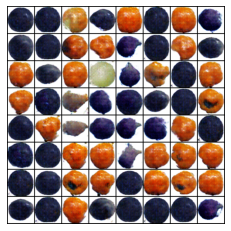

In [28]:
img_list = []
G_losses = []
D_losses = []
iters = 0

for epoch in range(1,num_epochs+1):
    for i,(real,_) in enumerate(dataloader,1):
        batch_size = real.size(0)
        real = real.to(device)
        label = torch.full((batch_size, ), 1,dtype=torch.float).to(device)
        
        output = netD(real).view(-1)
        
        netD.zero_grad()
        loss_D_real = criterion(output, label)
        loss_D_real.backward()
        D_X = output.mean().item()
        
        noise = torch.randn(batch_size,size_z,1,1).to(device)
        fake = netG(noise)
        label.fill_(0)
        
        output = netD(fake.detach()).view(-1)
        
        loss_D_fake = criterion(output, label)
        loss_D_fake.backward()
        D_G_Z1 = output.mean().item()
        
        loss_D = loss_D_real + loss_D_fake
        
        optD.step()
        
        
        netG.zero_grad()
        label.fill_(1)
        output = netD(fake).view(-1)
        
        loss_G = criterion(output, label)
        loss_G.backward()
        optG.step()
        D_G_Z2 = output.mean().item()
        
        
        if i%50 == 0:
            print(f"Epoch : [{epoch}/{num_epochs}], Batch : [{i}/{len(dataloader)}], Loss_D : {loss_D.item():.3f}, Loss_G : {loss_G.item():.3f}, D(x) : {D_X:.3f}, D(G(z)) : {D_G_Z1:.3f}/{D_G_Z2:.3f}")
        
        D_losses.append(loss_D.item())
        G_losses.append(loss_G.item())
                  
    with torch.no_grad():
        fake = netG(fixed_noise).cpu()
    img_grid = torchvision.utils.make_grid(fake, normalize=True)
    img_list.append(img_grid)
    if epoch%10 == 0:
        print("Epoch :",epoch)
        show_image_grid(img_grid)

## Plotting Generator and Discriminator loss

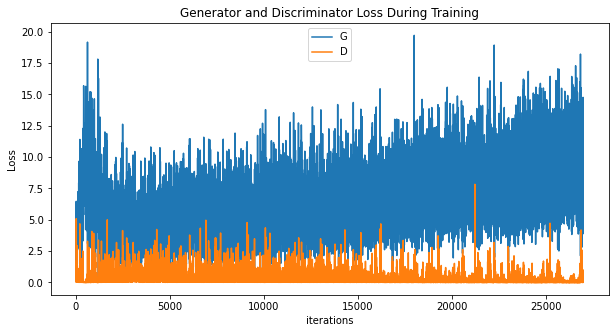

In [29]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

## Animation of fake generated samples

Animation size has reached 21343567 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


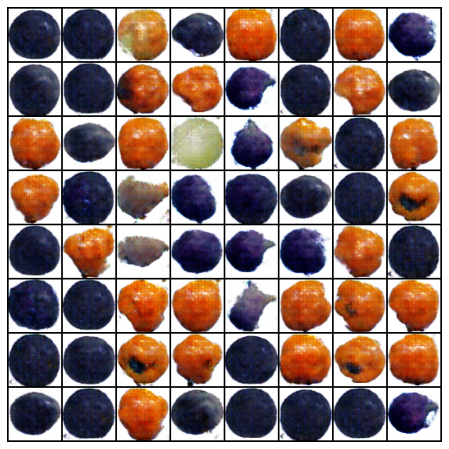

In [30]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)
HTML(ani.to_jshtml())

## Real vs Fake samples

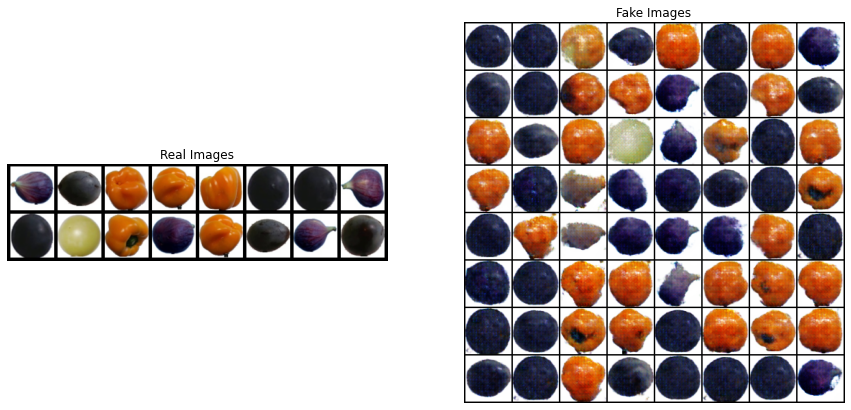

In [31]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(torchvision.utils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()